In [3]:
import polars as pl 
import plotly.graph_objects as go
import plotly.express as px
import pyopenms as oms
import sys
import os

In [4]:

def load_mass_spectra(filename):
    exp = oms.MSExperiment()  # type: PeakMap

    loader = oms.MzXMLFile()

    loadopts = loader.getOptions()  # type: PeakFileOptions

    loadopts.setMSLevels([1])

    loadopts.setSkipXMLChecks(True)

    loadopts.setIntensity32Bit(True)

    loadopts.setIntensityRange(oms.DRange1(oms.DPosition1(5000), oms.DPosition1(sys.maxsize)))

    loader.setOptions(loadopts)

    loader.load(filename, exp)

    exp.updateRanges()

    expandcols = ["RT", "mz", "inty"]

    spectraarrs2d = exp.get2DPeakDataLong(

        exp.getMinRT(), exp.getMaxRT(), exp.getMinMZ(), exp.getMaxMZ()

    )
    spectradf = pl.DataFrame(dict(zip(expandcols, spectraarrs2d)))
    return spectradf

In [5]:
path='example data/'
list_of_mass_spectra=[]
list_of_UV_chrom=[]
for root, dirs, files in os.walk(path):
    for name in files:
        if 'mzXML' in name:
            list_of_mass_spectra.append(name)
        if '.txt' in name:
            list_of_UV_chrom.append(name)
list_of_mass_spectra.sort(reverse=True)
list_of_UV_chrom.sort(reverse=True)

In [6]:
list_of_mass_spectra,list_of_UV_chrom

(['231120 troubleshoot_unknow-old_10_08.mzXML',
  '231120 troubleshoot_unknow-new_9_07.mzXML',
  '231120 troubleshoot_none_1_01.mzXML',
  '231120 troubleshoot_Buffer(231118)_2_02.mzXML',
  '231120 troubleshoot_231109-old_4_02.mzXML',
  '231120 troubleshoot_231109-new_3_01.mzXML',
  '231120 troubleshoot_220729-old_6_04.mzXML',
  '231120 troubleshoot_220729-new_5_03.mzXML',
  '231120 troubleshoot_220414-old_8_06.mzXML',
  '231120 troubleshoot_220414-new_7_05.mzXML',
  '231120 troubleshoot_220414-dilution-new8_18_16.mzXML',
  '231120 troubleshoot_220414-dilution-new7_17_15.mzXML',
  '231120 troubleshoot_220414-dilution-new6_16_14.mzXML',
  '231120 troubleshoot_220414-dilution-new5_15_13.mzXML',
  '231120 troubleshoot_220414-dilution-new4_14_12.mzXML',
  '231120 troubleshoot_220414-dilution-new3_13_11.mzXML',
  '231120 troubleshoot_220414-dilution-new2_12_10.mzXML',
  '231120 troubleshoot_220414-dilution-new1_11_09.mzXML'],
 ['231120 troubleshoot_unknow-old_10_08.txt',
  '231120 troublesho

In [7]:
data_UV = {}
for name in list_of_UV_chrom:
    if 'checkpoint' not in name:
        data_UV[name+'_205nm'] = pl.read_csv(path+name,skip_rows=23,skip_rows_after_header=1,n_rows=9001,new_columns=['Time (min)','Abs (µAu)'])
        data_UV[name+'_280nm'] = pl.read_csv(path+name,skip_rows=23+9001+10,skip_rows_after_header=1,n_rows=9001,new_columns=['Time (min)','Abs (µAu)'])

In [8]:
mass_data = {}
for name in list_of_mass_spectra:
    mass_data[name] = load_mass_spectra(path+name)

In [7]:
for x in mass_data.keys():
    print(x)

231120 troubleshoot_unknow-old_10_08.mzXML
231120 troubleshoot_unknow-new_9_07.mzXML
231120 troubleshoot_none_1_01.mzXML
231120 troubleshoot_Buffer(231118)_2_02.mzXML
231120 troubleshoot_231109-old_4_02.mzXML
231120 troubleshoot_231109-new_3_01.mzXML
231120 troubleshoot_220729-old_6_04.mzXML
231120 troubleshoot_220729-new_5_03.mzXML
231120 troubleshoot_220414-old_8_06.mzXML
231120 troubleshoot_220414-new_7_05.mzXML
231120 troubleshoot_220414-dilution-new8_18_16.mzXML
231120 troubleshoot_220414-dilution-new7_17_15.mzXML
231120 troubleshoot_220414-dilution-new6_16_14.mzXML
231120 troubleshoot_220414-dilution-new5_15_13.mzXML
231120 troubleshoot_220414-dilution-new4_14_12.mzXML
231120 troubleshoot_220414-dilution-new3_13_11.mzXML
231120 troubleshoot_220414-dilution-new2_12_10.mzXML
231120 troubleshoot_220414-dilution-new1_11_09.mzXML


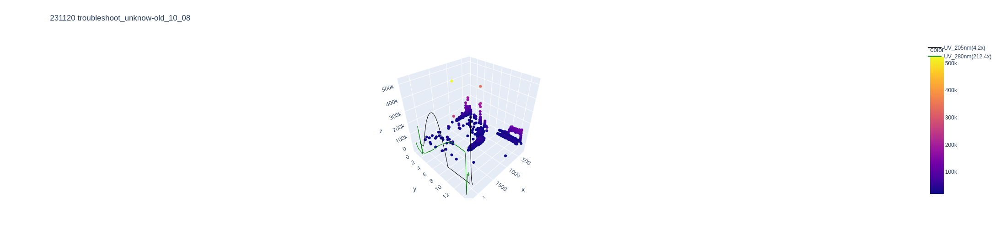

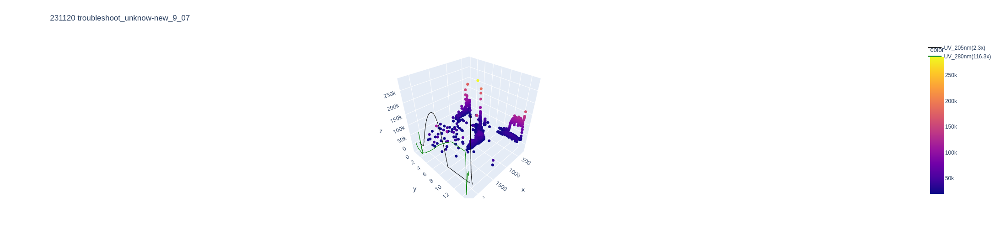

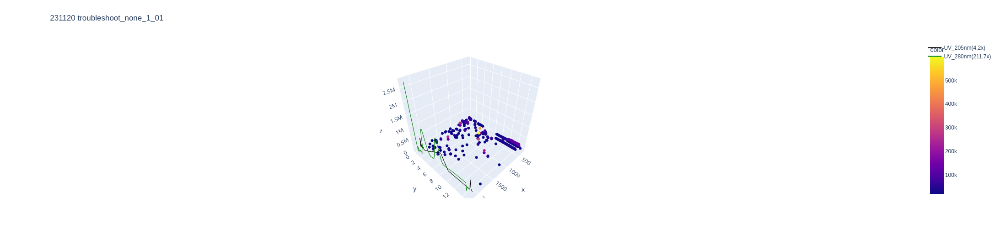

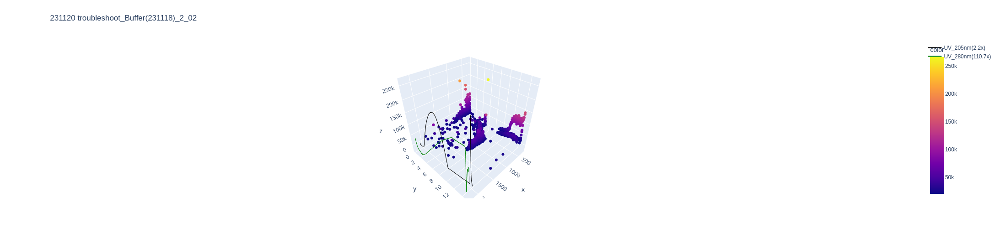

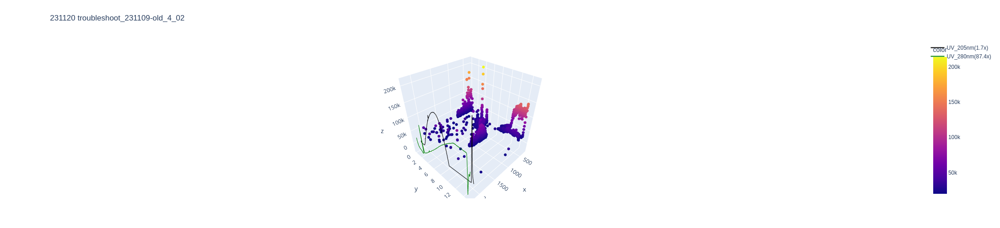

...

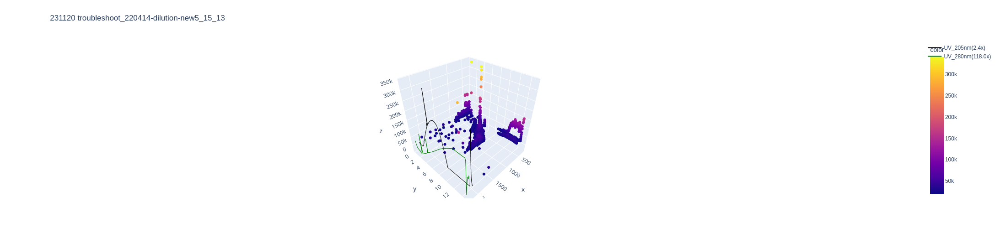

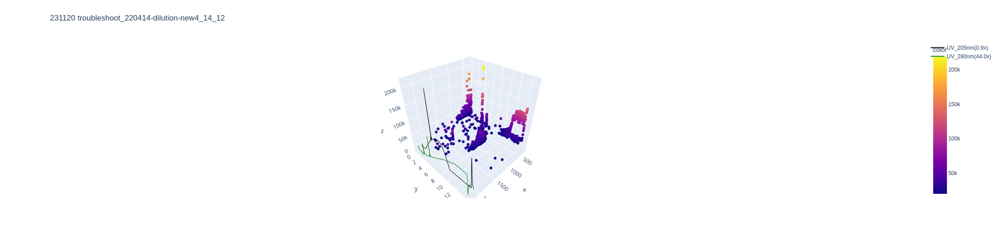

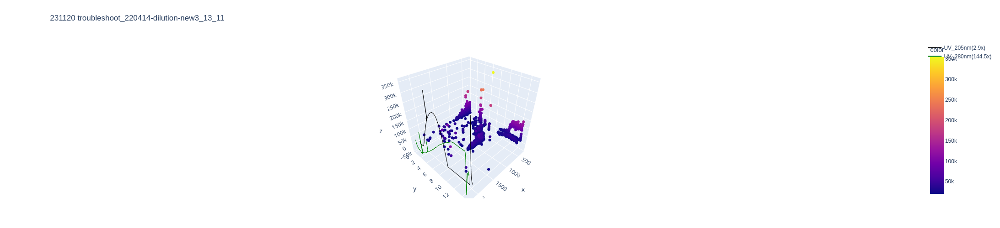

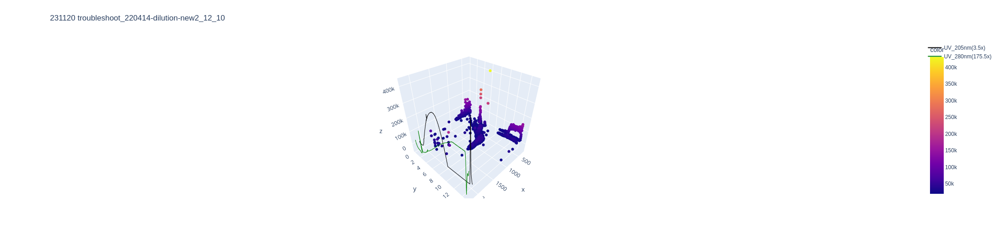

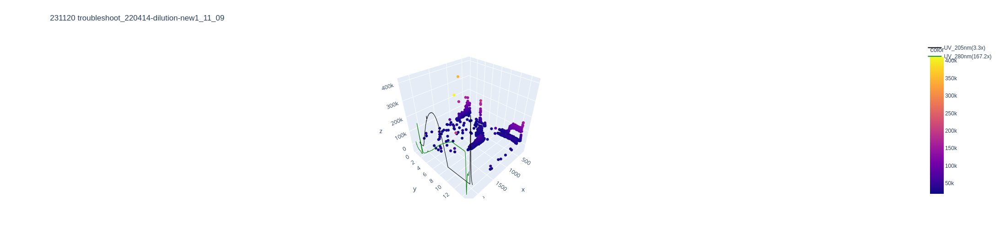

In [13]:
for key in mass_data.keys():
    name = key.split('.')[0]
    df = mass_data[key].filter(pl.col('inty')>20000).filter(pl.col('mz')>300)
    z=df['inty']
    y=df['RT']/60
    x=df['mz']
    fig = px.scatter_3d(z=z,y=y,x=x,color=z)
    fig.update_traces(marker_size = 2)
    UV_205 = data_UV[name+'.txt'+'_205nm'].filter(pl.col('Time (min)')>0.4).filter(pl.col('Abs (µAu)')>0)
    UV_280 = data_UV[name+'.txt'+'_280nm'].filter(pl.col('Time (min)')>0.4)#.filter(pl.col('Abs (µAu)')>0)
    normalizer = df['inty'].max()/UV_205['Abs (µAu)'].max()
    fig.add_trace(go.Scatter3d(
    y=UV_205['Time (min)'],z=UV_205['Abs (µAu)']*normalizer,x=[2100]*9001,
    mode='lines',
    line=dict(
        color='black',
        width=2
    ),
    name='UV_205nm'+'('+str(round(normalizer,1))+'x)'
    ))
    fig.add_trace(go.Scatter3d(
        y=UV_280['Time (min)'],z=UV_280['Abs (µAu)']*normalizer*50,x=[2200]*9001,
        mode='lines',
        line=dict(
            color='green',
            width=2
        ),
        name='UV_280nm'+'('+str(round(normalizer*50,1))+'x)'
    ))
    fig.update_layout(title=name, autosize=False,
                      width=750, height=500,
                      margin=dict(l=65, r=50, b=65, t=90))
    fig.show()

If you want to export a single graph as pdf in slightly higher resolution than "Download as png" gives:

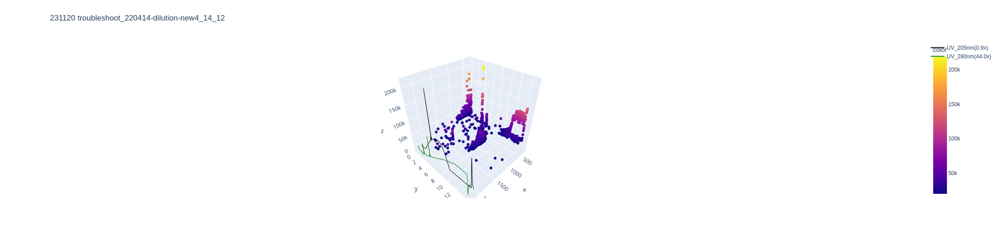

In [19]:
for key in ["231120 troubleshoot_220414-dilution-new4_14_12.mzXML"]:
    name = key.split('.')[0]
    df = mass_data[key].filter(pl.col('inty')>20000).filter(pl.col('mz')>300)
    z=df['inty']
    y=df['RT']/60
    x=df['mz']
    fig = px.scatter_3d(z=z,y=y,x=x,color=z)
    fig.update_traces(marker_size = 2)
    UV_205 = data_UV[name+'.txt'+'_205nm'].filter(pl.col('Time (min)')>0.4).filter(pl.col('Abs (µAu)')>0)
    UV_280 = data_UV[name+'.txt'+'_280nm'].filter(pl.col('Time (min)')>0.4)#.filter(pl.col('Abs (µAu)')>0)
    normalizer = df['inty'].max()/UV_205['Abs (µAu)'].max()
    fig.add_trace(go.Scatter3d(
    y=UV_205['Time (min)'],z=UV_205['Abs (µAu)']*normalizer,x=[2100]*9001,
    mode='lines',
    line=dict(
        color='black',
        width=2
    ),
    name='UV_205nm'+'('+str(round(normalizer,1))+'x)'
    ))
    fig.add_trace(go.Scatter3d(
        y=UV_280['Time (min)'],z=UV_280['Abs (µAu)']*normalizer*50,x=[2200]*9001,
        mode='lines',
        line=dict(
            color='green',
            width=2
        ),
        name='UV_280nm'+'('+str(round(normalizer*50,1))+'x)'
    ))
    fig.update_layout(title=name, autosize=False,
                      width=750, height=500,
                      margin=dict(l=65, r=50, b=65, t=90))
    fig.write_image("plots/fig1.pdf")
    fig.show()

If you want really good resolution than replotting it with matplotlib might be a better option.

In [1]:

import matplotlib.pyplot as plt

In [9]:
df = mass_data["231120 troubleshoot_220414-dilution-new4_14_12.mzXML"].with_columns(pl.col('RT')/60,pl.col('mz').round(0))#.filter(pl.col('inty')>20000).filter(pl.col('mz')>200)
z=df['inty']
y=df['RT']
x=df['mz']

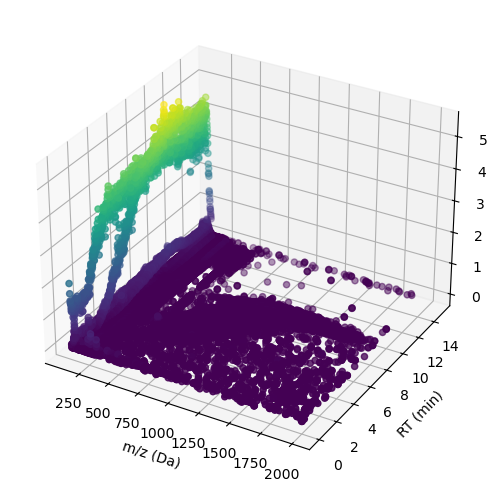

<Figure size 640x480 with 0 Axes>

In [18]:
fig, ax = plt.subplots(figsize=(5,5),subplot_kw={"projection": "3d"})
plt.tight_layout()
ax.scatter(x, y, z,c=z)
ax.set_xlabel('m/z (Da)')
ax.set_ylabel('RT (min)')
ax.set_zlabel('Intensity (a.u.)')
#plt.tight_layout()
fig.set_tight_layout(True)
plt.show()
#plt.subplots_adjust(left=None, bottom=None, right=.8, top=None, wspace=None, hspace=None)
plt.savefig('plots/MS-high-res.pdf')
plt.savefig('plots/MS-high-res.png',dpi=300)

And for LC-part:

In [14]:
1e6

1000000.0

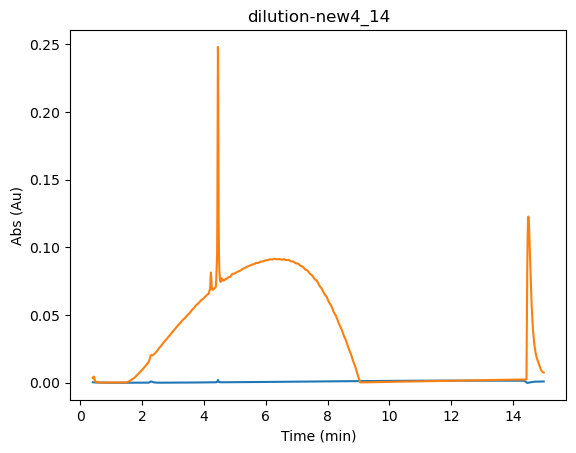

In [17]:
name="231120 troubleshoot_220414-dilution-new4_14_12"
UV_205 = data_UV[name+'.txt'+'_205nm'].filter(pl.col('Time (min)')>0.4).filter(pl.col('Abs (µAu)')>0)
UV_280 = data_UV[name+'.txt'+'_280nm'].filter(pl.col('Time (min)')>0.4)#.filter(pl.col('Abs (µAu)')>0)
plt.plot(UV_280['Time (min)'],UV_280['Abs (µAu)']/1e6)
plt.plot(UV_205['Time (min)'],UV_205['Abs (µAu)']/1e6)
plt.xlabel('Time (min)')
plt.ylabel('Abs (Au)')
plt.title('dilution-new4_14')
plt.savefig('plots/LC-high-res.pdf')
plt.savefig('plots/LC-high-res.png',dpi=300)